<h1><center>LINEAR REGRESSION</center></h1>

## 1. Importing libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
from mpl_toolkits.mplot3d import Axes3D
import plotly.io as pio
pio.renderers.default = "notebook"

## 2. Analyzing Training Data

### Loading Training data

The data corresponds to house sales in Ames, Iowa. All data was collected from: https://www.kaggle.com/c/house-prices-advanced-regression-techniques/overview 

In [2]:
# We indicate the file location
file_name_train = 'Data/train.csv'
file_name_test = 'Data/test.csv'
train_data = pd.read_csv(file_name_train)
test_data = pd.read_csv(file_name_test)

# We visualize first 100 training data samples (houses)
train_data.head(100)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,96,60,RL,NaN,9765,Pave,NaN,IR2,Lvl,AllPub,...,0,NaN,NaN,Shed,480,4,2009,WD,Normal,185000
96,97,20,RL,78.0,10264,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2006,WD,Normal,214000
97,98,20,RL,73.0,10921,Pave,NaN,Reg,HLS,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,94750
98,99,30,RL,85.0,10625,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,Shed,400,5,2010,COD,Abnorml,83000


We want to see the model in two dimensions. Thus, we are going to consider ONLY ONE feature (the area of the first floor) and the response variable (the price of the house)

In [5]:
# We load training data
x_train_pd = train_data['1stFlrSF']
y_train_pd = train_data['SalePrice']

x_train_list = x_train_pd.values.tolist()
y_train_list = y_train_pd.values.tolist()

x_train = np.array(x_train_list, dtype='float64')
x_train = x_train.reshape(x_train.shape[0], 1)

y_train = np.array(y_train_list, dtype='float64')
y_train = y_train.reshape(y_train.shape[0], 1)

# We load validation data
x_test_pd = test_data['1stFlrSF']
x_test_list = x_test_pd.values.tolist()
x_test = np.array(x_test_list, dtype='float64')
x_test = x_test.reshape(x_test.shape[0], 1)

print(x_train.shape, y_train.shape, x_test.shape)

(1460, 1) (1460, 1) (1459, 1)


### Visualizing training data

We plot the data:

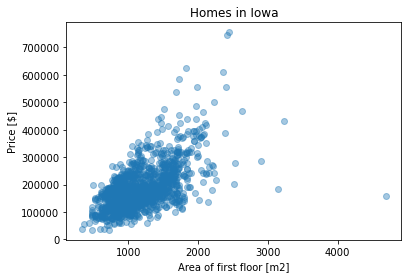

In [11]:
plt.figure()
plt.scatter(x_train, y_train, alpha = 0.4)
plt.title('Homes in Iowa')
plt.xlabel('Area of first floor [m2]')
plt.ylabel('Price [$]')
plt.show()

We want to consider a second feature: the surface area of the secon floor

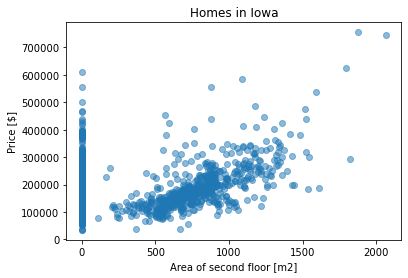

In [12]:
x_train_pd_2 = train_data['2ndFlrSF']
x_train_list_2 = x_train_pd_2.values.tolist()
x_train_2 = np.array(x_train_list_2, dtype='float64').reshape(x_train.shape[0], 1)

# Plotting data
plt.figure()
plt.scatter(x_train_2, y_train, alpha = 0.5)
plt.title('Homes in Iowa')
plt.xlabel('Area of second floor [m2]')
plt.ylabel('Price [$]')
plt.show()

Graph in 3D (considering the two features: surface of first floor and surface of second floor)

In [15]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Scatter3d(x=list(x_train[:,0]), 
                                   y=list(x_train_2[:,0]), 
                                   z=list(y_train[:,0]),
                                   marker=dict(
                                       size=4,
                                       colorscale='Viridis',   # choose a colorscale
                                       opacity=0.8
                                   ),
                                   mode='markers')
                     ])
fig.update_layout(
    title={
        'text': "<b>Homes in Iowa</b>",
        'y':0.8,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    font=dict(
        family="Arial, monospace",
        size=12,
        color="black"
    ),
    scene = dict(
                    xaxis_title='<b>Area of 1st floor </b>',
                    yaxis_title='<b>Area of 2nd floor </b>')
)
fig.show()

## 2. Creating the hypothesis, cost function and gradient descent

### Creating the hypothesis

The hypothesis for one feature (surface area of firts floor) is defined as: 

$$h(x)=w^{T}x$$

In [86]:
# Hypothesis function
def h(w, x):
    """
        Evaluates the corresponding feature vector using a linear hypothesis, 
        and returns the hyperplane value corresponding to that specific feature vector. 
        
        params:
            w: [np_array]   a vector of weights with dimensions (1xn), where n represents 
                            the number of weights.
                            
            x: [np_array]   a matrix of feature variables with dimensions (nxm), 
                            where n represents the number of feature variables and 
                            m the number of training examples
        returns:
            h: [double] the estimation performed by the linear model h=w'*x
    """
    return w.T.dot(x)

# We look at one training example
x0 = 1 # intersection
x1 = x_train[0][0]

x = np.array([x0, x1], dtype='float64')
x = x.reshape((x.shape[0], 1))

# We assign an ARBITRARY vector of parameters w 
w0 = 3 # intersection
w1 = 100
w = np.array([w0, w1], dtype='float64')
w = w.reshape((w.shape[0], 1))

# We predict
pred = h(w, x)
print(f'Prediction: {pred[0][0]} USD')
print(f'Real label: {y_train[0][0]} USD')

Prediction: 85603.0 USD
Real label: 208500.0 USD


### Plotting the hypothesis
We compute predictions for all our training samples (houses).

Shape of the vector of predictions: (1, 1460)


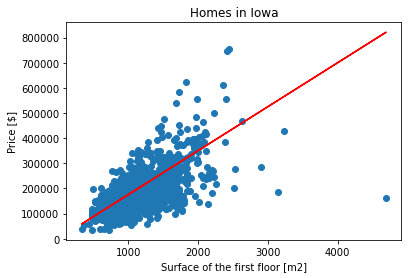

In [87]:
# We add a column of ones to consider the intersection
x_train_b =  np.insert(x_train, 0, 1, axis=1)
x_train_b = x_train_b.T

# We define an ARBITRARY vector of paremeters (weights): [w0, w1]
w0 = 0 # intersection
w1 = 175
w = np.array([w0, w1], dtype='float64')
w = w.reshape((w.shape[0], 1))

preds = h(w, x_train_b)
print(f'Shape of the vector of predictions: {preds.shape}')

plt.figure()
plt.scatter(x_train, y_train, alpha = 1)
plt.plot(x_train, preds.T, color='r')
plt.title('Homes in Iowa')
plt.xlabel('Surface of the first floor [m2]')
plt.ylabel('Price [$]')
plt.show()

### Creating the cost function

We define the cost function as the Mean Squared Error (MSE):

$$cost(w) = \frac{1}{2m}\sum_{i=1}^{m}(h(x)^{(i)}-y^{(i)})^{2}=\frac{1}{2m}(w^{T}X-\vec{y})^{T}(w^{T}X-\vec{y})$$

In [88]:
# Cost function
def cost(w, x, y):
    """
        params:
            w: [np_array] a vector of weights with dimensions (nx1), where n represents the number of weights.
            x: [np_array] a vector of feature variables with dimensions (nxm), 
                where n represents the number of feature variables and m the number of training examples
            y: [np_array] a vector of feature variables with dimensions (mx1), 
                where m represents the number of target variables
        returns:
            cost: [double] the mean squared error
    """
    return (1/(2*x.shape[1])) * (np.sum(np.square(h(w, x).T-y)))

### Plotting the cost function

We are going to plot the cost function for 300 x 300 possible pairs of parameters w0 and w1 to see how are cost function is defined by a convex shape (has a global minimum). 

In [89]:
import plotly.graph_objects as go

num_data = 800

w0_v = np.arange(-num_data/2, num_data/2, dtype='float64')
w1_v = np.arange(-num_data/2, num_data/2, dtype='float64')

X, Y = np.meshgrid(w0_v, w1_v)

# We initialize our matrix of MSE
mse = np.zeros((num_data, num_data))

# We obtain the MSE for each possible combination of w0 and w1
for i in range(num_data):
    for j in range(num_data):
        w = np.array([w0_v[i], w1_v[j]])
        w = w.reshape((w.shape[0], 1))
        mse[i, j] = cost(w, x_train_b, y_train)
    
# We plot the cost function in 3D
fig = go.Figure(data=[go.Surface(z=mse, x=X, y=Y)])

fig.update_layout(
    title={
        'text': "<b>Cost function</b>",
        'y':0.8,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    font=dict(
        family="Arial, monospace",
        size=12,
        color="black"
    ),
    width=500, 
    height=500,
    margin=dict(l=65, r=50, b=65, t=90),
    scene = dict(
        xaxis_title='<b>Weight w0</b>',
        yaxis_title='<b>Weight w1</b>')
)

fig.show()

### Computing the gradient (cost function)

We recall the gradient for the MSE (cost function) in linear regression:

$$\bigtriangledown _{w}cost(w)= \frac{1}{m}(\vec{y}-h(x))\vec{x} $$

In [90]:
# Gradient of the cost function (MSE)
def dJ(w, x, y):
    """
        params:
            w: [np_array] a vector of weights with dimensions (nx1), where n represents the number of weights.
            x: [np_array] a vector of feature variables with dimensions (nxm), 
                where n represents the number of feature variables and m the number of training examples
            y: [np_array] a vector of feature variables with dimensions (mx1), 
                where m represents the number of target variables
        returns:
            dJ: [double] the derivative of the mean squared error
    """
    e = h(w, x).T - y
    return (1 / (x.shape[1])) * np.dot(x, e)

### Implementing the Gradient Descent Algorithm

We will implement the gradient descent algorithm. Thus, we combine every function that we programmed before: cost function, hypothesis and the gradient functions.

In [91]:
def optimize_LMS(x, y, num_iter, alpha, w = None):
    """
    We calculate gradient descent for minimizing the MSE to obtain the best linear hypothesis.
        params:
            x: [np_array] a vector of feature variables with dimensions (nxm), 
                where n represents the number of feature variables and m the number of training examples
            y: [np_array] a vector of feature variables with dimensions (mx1), 
                where m represents the number of target variables
            num_iter: [int] an integer indicating the number of iterations of the Gradient Descent algorithm
            alpha: [double] learning rate constant specifying the magnitude update step
            w: [np_array] vector that contains the initial weights to start optimzing the model with dimensions (n x 1)
                
        return:
            j: [np_array] a vector (num_iter x 1) containing all cost function evaluations during training
            w: [np_array] a vector of the final optimized weights with dimensions (nx1)
    """
    
    if w is None:
        # We initialize the vector of weights randomly
        w = np.random.randn(x.shape[0], 1)
    
    # We create a vector that will contain the cost function evaluated
    # at each iteration of the gradient descent algortihm.
    j = np.zeros(num_iter)
    
    # We update the weights using gradient descent 
    # by the specified number of iterations
    for i in range(num_iter):

        # We compute the hypothesis (predict)
        preds = h(w, x)

        # We update the weights using the gradient descent rule. 
        w = w - alpha * dJ(w, x, y)

        # We save the cost for the current iteration of gradient descent
        j[i] = cost(w, x, y)

    return w, j

### Example with random data

The resulting code plots the hypothesis (straight line) which is comprised by the parameters w0 and w1: 

$$f(x)=h(x)=w^{T}x=w_{0}+w_{1}*x$$

every 25 iterations of the gradient descent algorithm.

In this example, we have created a random data set. Later on, we are going to fit the line using the datset of the houses from Iowa.

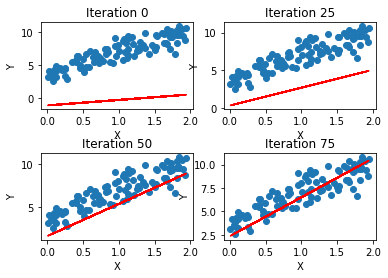

In [92]:
# We create a random data set.
X = 2*np.random.rand(100,1)
Y = 4 + 3*X + np.random.randn(100,1)

# We add a column of ones to the features matrix to take into account the intercept
X_b =  np.insert(X, 0, 1, axis=1)
X_b = np.transpose(X_b)

# We intialize the vector of weights: w (opcional)
w = np.random.randn(x.shape[0], 1)

# We define the training parameters
max_iter = 100 # number of gradient descent iterations
step_iter = 25 # intervals for plotting
alpha = 0.01 # learning rate

num_i = int(round(np.sqrt(max_iter/step_iter)))
it = list(range(0, max_iter, step_iter))

fig, axs = plt.subplots(num_i, num_i)
fig.subplots_adjust(hspace=0.5)
counter = 0

# We run gradient descent
for i in range(num_i):
    for k in range(num_i):
                
        # Se corre el algoritmo
        w, j = optimize_LMS(X_b, Y, it[counter], alpha, w)

        # Graficamos el costo
        axs[i, k].scatter(X, Y, alpha = 1)
        axs[i, k].set_title('Iteration {0}'.format(it[counter]))
        axs[i, k].set_xlabel('X')
        axs[i, k].set_ylabel('Y') 
        preds = h(w, X_b)
        axs[i, k].plot(X, preds.T, color='r')
        
        counter += 1

### Modifying the Learning Rate: $\alpha$

In the following code we see what happens to the cost function as we vary the learning rate $\alpha$. You can see that when alpha becomes larger, the amount of time required to find the minimum of the MSE decreases. Even so, when $\alpha$ is too large, the optimization algorithm diverges!

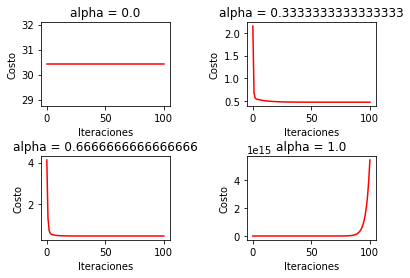

In [93]:
# We are going to try four values of alpha: [0, 0.333, 0.666, 1.0]
num_alphas = 4
alphas = np.linspace(0, 1, num_alphas)
num_i = int(round(np.sqrt(num_alphas)))

fig, axs = plt.subplots(num_i, num_i)
fig.subplots_adjust(hspace=0.6, wspace=0.6)
counter = 0
it = np.linspace(0, max_iter, max_iter)

for i in range(num_i):
    for k in range(num_i):
    
        # Randoly intiailize the vector of weights
        w = np.random.randn(x.shape[0], 1)

        w, j = optimize_LMS(X_b, Y, max_iter, alphas[counter], w)

        # Plot the cost function with the corresponding alpha
        axs[i, k].set_title('alpha = {0}'.format(alphas[counter]))
        axs[i, k].set_xlabel('Iteraciones')
        axs[i, k].set_ylabel('Costo') 
        axs[i, k].plot(it, j, color='r')
        
        counter += 1


### Example with the data set of houses in Iowa

Let us implement linear regression with our real data set. We plot our data first:

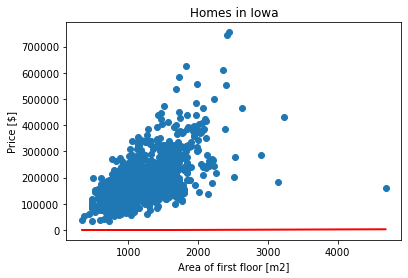

In [94]:
# We initialize our vector of weights randomly
w = np.random.randn(x.shape[0], 1)

# We plot the data. 
plt.figure()
plt.scatter(x_train, y_train, alpha = 1)
plt.title('Homes in Iowa')
plt.xlabel('Area of first floor [m2]')
plt.ylabel('Price [$]')
preds = h(w, x_train_b)
plt.plot(x_train, np.transpose(preds), color='r')

We run gradient descent and plot the hypothesis (straight line) that was learnt by the algorithm:

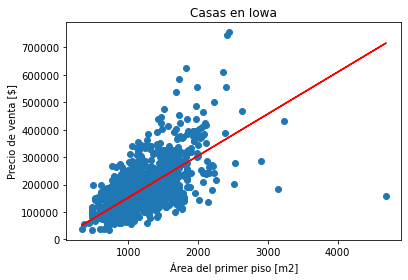

In [95]:
num_iter = 100 # number of iterations of gradient descent. 
alpha = 0.000001 # learning rate
w, j = optimize_LMS(x_train_b, y_train, num_iter, alpha, w)

# We plot the data with the learnt hypothesis
plt.figure()
plt.scatter(x_train, y_train, alpha = 1)
plt.title('Casas en Iowa')
plt.xlabel('Área del primer piso [m2]')
plt.ylabel('Precio de venta [$]')
preds = h(w, x_train_b)
plt.plot(x_train, np.transpose(preds), color='r')

Now, we plot the cost function:

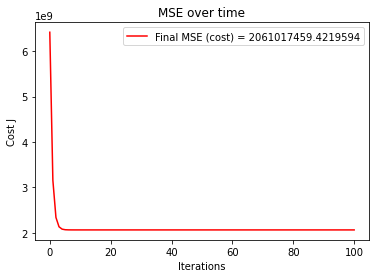

In [96]:
it = np.linspace(0, num_iter, 100)
plt.figure()
plt.title('MSE over time')
plt.xlabel('Iterations')
plt.ylabel('Cost J') 
plt.plot(it, j, color='r', label=f'Final MSE (cost) = {j[-1]}')
plt.legend()
plt.show()